#**KNN classifier**






#Import

In [ ]:
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass

%load_ext tensorboard

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
import matplotlib.pyplot as plt
import os
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorboard.plugins import projector
import random
import keras
import numpy as np
import matplotlib.pyplot as plt
import itertools
from tqdm import tqdm
import tensorflow_datasets as tfds
from PIL import Image, ImageOps
import math

#Variabili
img_height = 256
img_width = 256
batch_size = 1
class_names = ['A_Silent_Voice', 'Attack_on_Titans', 'Death_Note', 'Demon_Slayer', 'Dragon_Ball', 'Fruits_Basket', 'Full_Metal_Alchemist_Brotherhood',
               'Gintama', 'Hunter_X_Hunter', 'Jujutsu_Kaisen', 'My_Hero_Academia', 'Naruto', 'One_Punch_Man', 'One_piece', 'Re_ZERO', 'Steins;Gate']

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Funzioni

In [ ]:
def create_dataset(dataset_path, preprocessing_function = None):
      datagen = keras.preprocessing.image.ImageDataGenerator(preprocessing_function=preprocessing_function)

      data = datagen.flow_from_directory(
        dataset_path,
        target_size= (img_height, img_width),
        batch_size=batch_size,
        color_mode ='rgb',
        class_mode= 'sparse',
        classes = class_names,
        shuffle = True,
        seed = 123
        )
      return data

In [ ]:
def get_embeddings_from_dataset(embedding_model, dataset):

    embeddings = embedding_model.predict(dataset)
    labels = dataset.labels
    filenames = dataset.filenames

    return embeddings, labels, filenames

In [ ]:
def visualize_images(dataset):
  counter = 0
  plt.figure(figsize=(10, 10))
  for batch in dataset:
      images, labels = batch

      for i in range(len(images)):
          counter += 1
          ax = plt.subplot(3, 3, counter)
          plt.imshow(images[i].astype("uint8"))
          plt.title(class_names[int(labels[i])])
          plt.axis('off')

      if counter >= 9:
          break

  plt.tight_layout()
  plt.show()

In [ ]:
from scipy import stats
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score

def knn(test_values, test_labels, train_values, train_labels):
    paramk = 11  # parameter k of k-nearest neighbors
    numTrainImages = train_values.shape[0]

    arrayKNNLabels = np.array([])
    arrayL2Norm = np.array([])

    for j_train in range(numTrainImages):
        # Calcola le distanze euclidee tra tutti i campioni di test e i campioni di addestramento contemporaneamente
        l2norm = np.sum(((train_values[j_train] - test_values)) ** 2, axis=1) ** 0.5
        arrayL2Norm = np.append(arrayL2Norm, l2norm)

    # Reshape arrayL2Norm per tener conto di tutte le distanze
    arrayL2Norm = arrayL2Norm.reshape((numTrainImages, -1))

    # Trova gli indici dei k vicini più vicini per ciascun campione di test
    sIndex = np.argsort(arrayL2Norm, axis=0)[:paramk]

    # Estrai le etichette dei k vicini più vicini per ciascun campione di test
    kLabels = train_labels[sIndex]

    # Trova l'etichetta predetta per ciascun campione di test basata sulla maggioranza tra i k vicini più vicini
    predicted_labels = stats.mode(kLabels, axis=0).mode.flatten()

    # Calcola la matrice di confusione
    confusion_mat = confusion_matrix(test_labels, predicted_labels)

    #Calcola l'accuracy
    accuracy = accuracy_score(test_labels, predicted_labels)

    return test_labels, predicted_labels, confusion_mat, accuracy

In [ ]:
def show_predictions(ground_truth, prediction, filenames, dataset_path):
    plt.figure(figsize=(12, 12))

    for i in range(9):
        index = random.randint(0, len(ground_truth) - 1)

        img = Image.open(os.path.join(dataset_path, filenames[index]))
        ground_truth_label = class_names[ground_truth[index]]
        predicted_label = class_names[prediction[index]]

        predicted_color = 'green' if ground_truth_label == predicted_label else 'red'

        plt.subplot(3, 3, i + 1)
        plt.imshow(img)
        plt.title(f'GROUND_TRUTH: {ground_truth_label}\nPREDICTION: {predicted_label}', color=predicted_color)
        plt.axis('off')

    plt.show()

In [ ]:
def generate_sprite(filenames, dataset_path):
  grid = int(math.sqrt(len(filenames))) + 1
  image_height = int(2000 / grid)
  image_width = int(2000 / grid)


  big_image = Image.new( mode='RGB',
                        size=(image_width * grid, image_height * grid),
                        color=(0,0,0) )

  for i in range(len(filenames)):

      row     = i // grid
      col     = i % grid
      img     = Image.open(os.path.join(dataset_path,filenames[i]))
      img     = img.resize((image_height, image_width), Image.Resampling.LANCZOS)
      row_loc = row * image_height
      col_loc = col * image_width

      big_image.paste(img, (col_loc, row_loc))


  big_image.save(os.path.join(log_dir, 'sprite_image.jpg'))
  return image_height, image_width

#Dataset#

In [ ]:
#CREAZIONE TRAIN DATASET
train_path = '/content/drive/MyDrive/Colab Notebooks/PROGETTO/_frames'
ds_train = create_dataset(train_path)

Found 3280 images belonging to 16 classes.


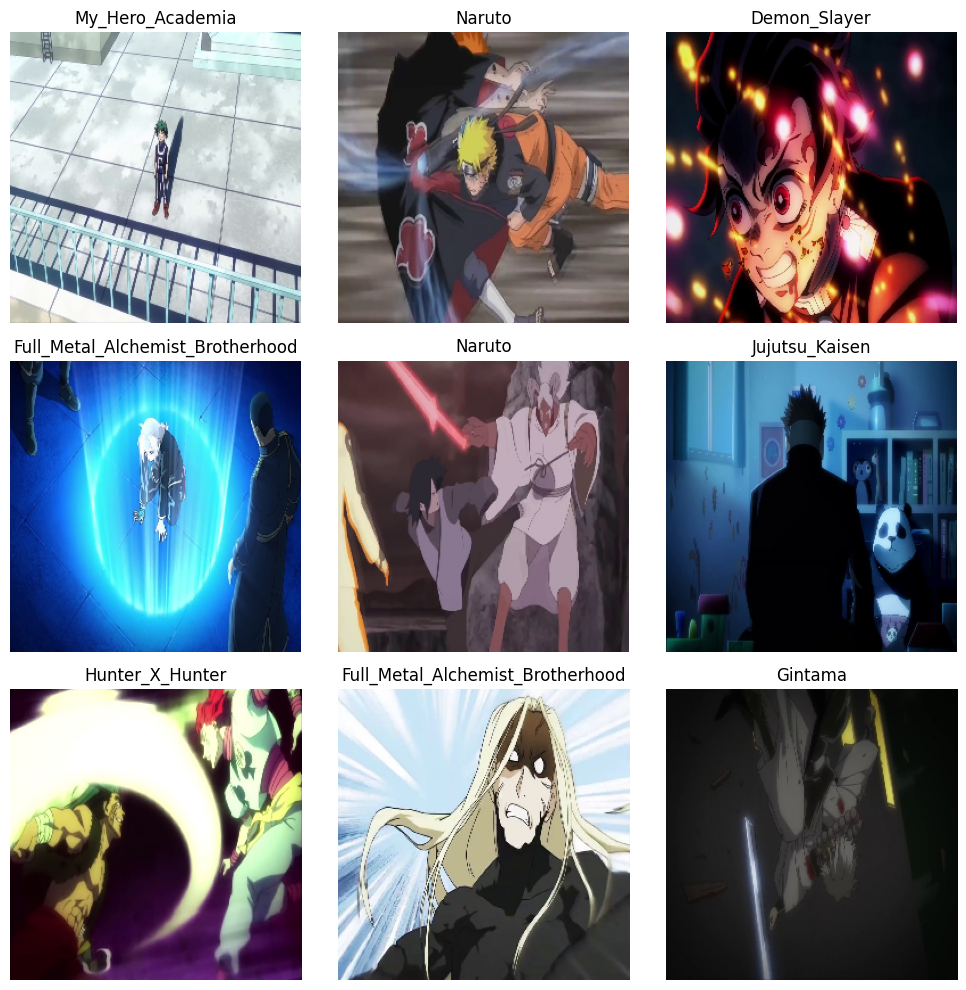

In [ ]:
#VISUALIZZAZIONE DATASET
visualize_images(ds_train)

In [ ]:
#CREAZIONE TEST DATASET
test_path = '/content/drive/MyDrive/Colab Notebooks/PROGETTO/_frames_test'
ds_test = create_dataset(test_path)

Found 714 images belonging to 16 classes.


#Base_model

In [ ]:
#definizione modello
input_shape = (img_height,img_width,3)
model = tf.keras.applications.resnet50.ResNet50(include_top=False, weights='imagenet', input_shape=input_shape)
x = model.layers[-1].output
output = keras.layers.GlobalAveragePooling2D(name='avg_pool')(x)


base_model = keras.Model(model.input, output)

base_model.compile()

94765736/94765736 [==============================] - 1s 0us/step


In [ ]:
base_model.summary()

In [ ]:
#FEATURE EXTRACTION TRAIN
train_values, train_labels, train_filenames = get_embeddings_from_dataset(base_model, ds_train)
#SALVATAGGIO DEL FEATURE EXTRACTION
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/train_values.npy",train_values)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/train_labels.npy",train_labels)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/train_filenames.npy",train_filenames)

3280/3280 [==============================] - 830s 252ms/step


In [ ]:
#LOAD TRAIN
train_values = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/train_values.npy")
train_labels = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/train_labels.npy")
train_filenames = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/train_filenames.npy")

In [ ]:
#FEATURE EXTRACTION TEST
test_values, test_labels, test_filenames = get_embeddings_from_dataset(base_model, ds_test)
#SALVATAGGIO DEL FEATURE EXTRACTION
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/test_values.npy",test_values)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/test_labels.npy",test_labels)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/test_filenames.npy",test_filenames)

714/714 [==============================] - 179s 250ms/step


In [ ]:
#LOAD TEST
test_values = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/test_values.npy")
test_labels = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/test_labels.npy")
test_filenames = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/test_filenames.npy")

In [ ]:
#KNN
ground_truth, prediction, confusion_matrix, accuracy = knn(test_values, test_labels, train_values, train_labels)

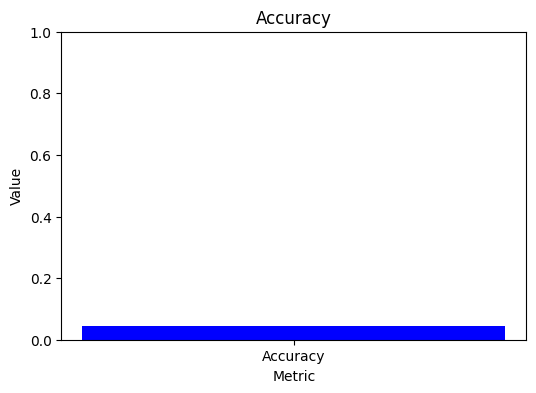

In [ ]:
#ACCURACY
plt.figure(figsize=(6, 4))
plt.bar(['Accuracy'], [accuracy], color='blue')
plt.xlabel('Metric')
plt.ylabel('Value')
plt.title('Accuracy')
plt.ylim(0, 1.0)
plt.show()

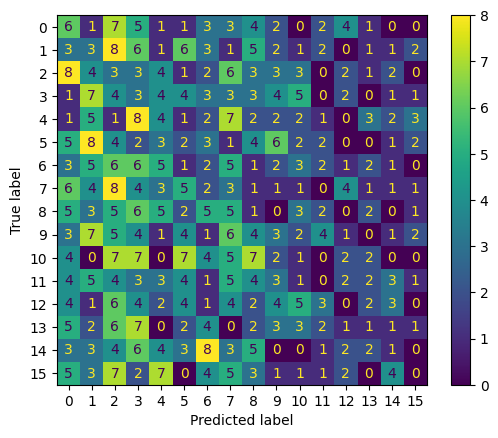

In [ ]:
#CONFUSION MATRIX
cm_display = ConfusionMatrixDisplay(confusion_matrix).plot()

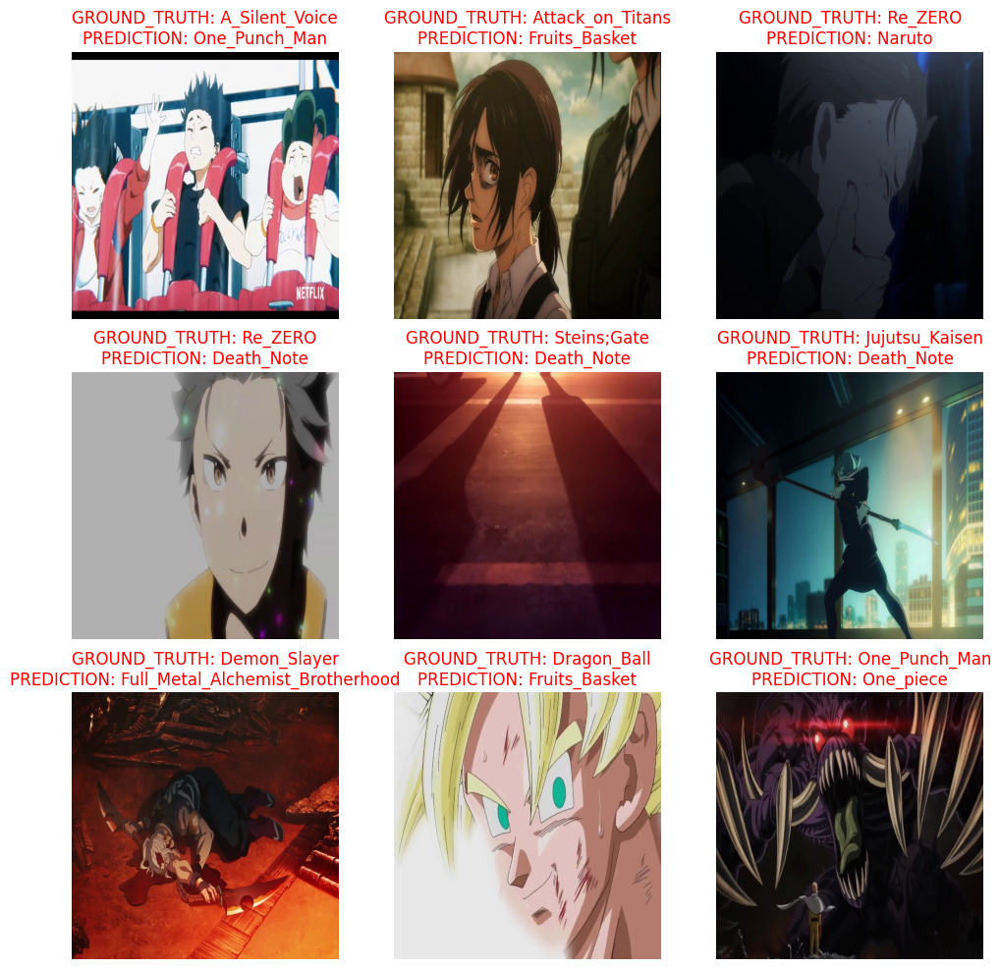

In [ ]:
show_predictions(ground_truth, prediction, test_filenames, test_path)

#Modello allenato#



In [ ]:
def contrastive_loss(y_true, y_pred):
    """Calculates the contrastive loss.

    Arguments:
        y_true: List of labels, each label is of type float32.
        y_pred: List of predictions of same length as of y_true,
                each label is of type float32.

    Returns:
        A tensor containing contrastive loss as floating point value.
    """
    y_true = tf.cast(y_true, dtype=tf.float32)
    margin = 1
    square_pred = tf.math.square(y_pred)
    margin_square = tf.math.square(tf.math.maximum(margin - (y_pred), 0))
    return tf.math.reduce_mean((1 - y_true) * square_pred + (y_true) * margin_square)

In [ ]:
checkpoint = '/content/drive/MyDrive/Colab Notebooks/PROGETTO/Modello_256x256_batchS128_BN_FT_LRadaptive0.0001/siamese_RRN_fineTuning_weights.31-0.22.hdf5'
siamese_RRN = keras.models.load_model(checkpoint, custom_objects={'contrastive_loss': contrastive_loss})

In [ ]:
for layer in siamese_RRN.layers:
  layer.trainable = True

In [ ]:
#MODEL SURGERY
print(siamese_RRN.layers[-2].output)

siamese = keras.Model(siamese_RRN.inputs[0], siamese_RRN.layers[-2].output)
siamese.summary()
siamese.output.shape

KerasTensor(type_spec=TensorSpec(shape=(None, 512), dtype=tf.float32, name=None), name='Normalizzatore_Features/l2_normalize:0', description="created by layer 'Normalizzatore_Features'")
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 Base_model_RESNET (Functio  (None, 512)               24636800  
 nal)                                                            
                                                                 
 Normalizzatore_Features (L  (None, 512)               0         
 ambda)                                                          
                                                                 
Total params: 24636800 (93.98 MB)
Trainable params: 24583680 (93.78 MB)
Non-trainable params: 53120 (207.50 KB)
__________________________

TensorShape([None, 512])

In [ ]:
#FEATURE EXTRACTION TRAIN
my_train_v, my_train_l, my_train_f = get_embeddings_from_dataset(siamese, ds_train)
#SALVATAGGIO DEL FEATURE EXTRACTION
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_train_values.npy",my_train_v)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_train_labels.npy",my_train_l)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_train_filenames.npy",my_train_f)

3280/3280 [==============================] - 889s 271ms/step


In [ ]:
#LOAD TRAIN
my_train_v = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_train_values.npy")
my_train_l = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_train_labels.npy")
my_train_f = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_train_filenames.npy")

In [ ]:
#FEATURE EXTRACTION TEST
my_test_v, my_test_l, my_test_f = get_embeddings_from_dataset(siamese, ds_test)
#SALVATAGGIO DEL FEATURE EXTRACTION
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_test_values.npy",my_test_v)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_test_labels.npy",my_test_l)
np.save("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_test_filenames.npy",my_test_f)

714/714 [==============================] - 205s 287ms/step


In [ ]:
#LOAD TEST
my_test_v = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_test_values.npy")
my_test_l = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_test_labels.npy")
my_test_f = np.load("/content/drive/MyDrive/Colab Notebooks/PROGETTO/save/my_test_filenames.npy")

In [ ]:
#KNN (se è già stato calcolato il knn per il basemodel in questa sessione darà un errore)
ground_truth, prediction, confusion_matrix, accuracy = knn(my_test_v, my_test_l, my_train_v, my_train_l)

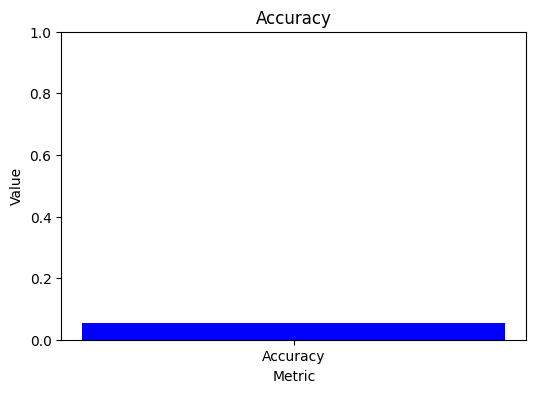

In [ ]:
#ACCURACY
plt.figure(figsize=(6, 4))
plt.bar(['Accuracy'], [accuracy], color='blue')
plt.xlabel('Metric')
plt.ylabel('Value')
plt.title('Accuracy')
plt.ylim(0, 1.0)
plt.show()

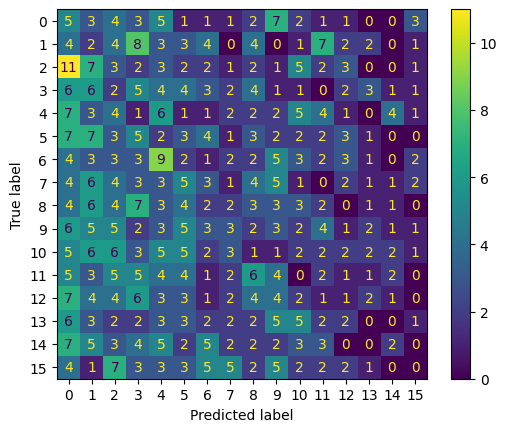

In [ ]:
#CONFUSION MATRIX
cm_display = ConfusionMatrixDisplay(confusion_matrix).plot()

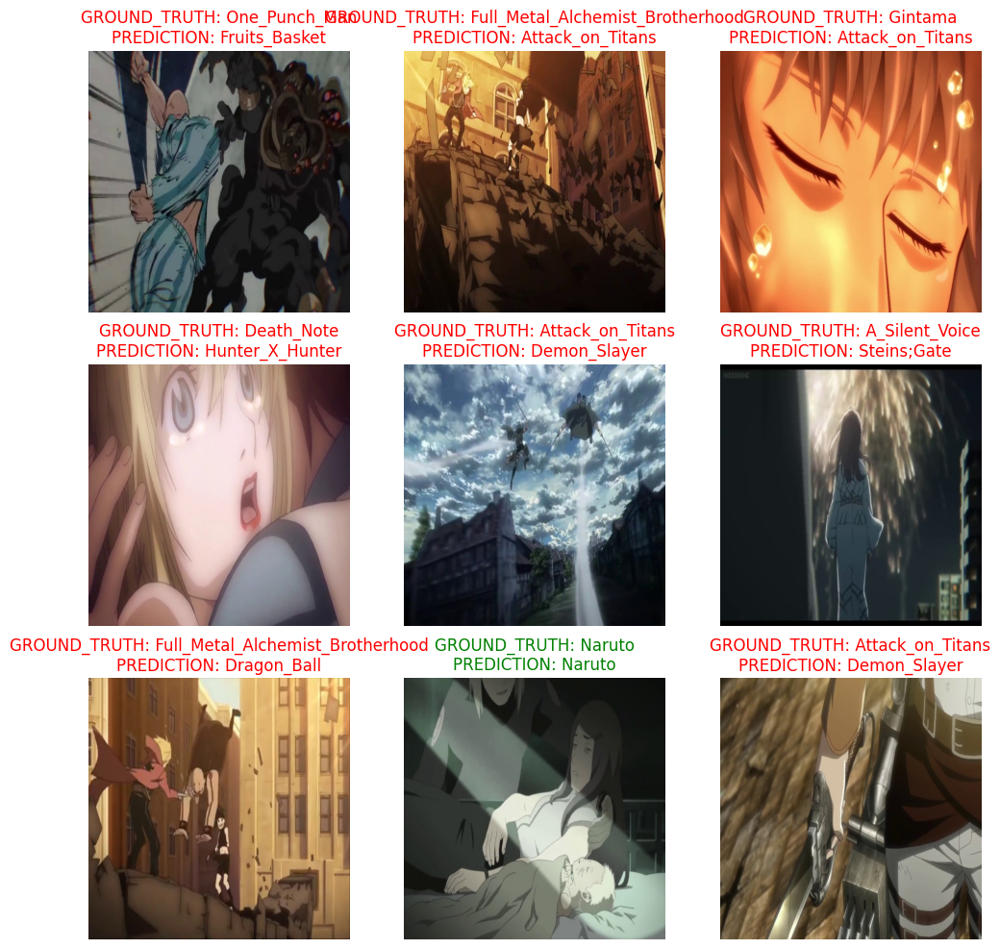

In [ ]:
show_predictions(ground_truth, prediction, my_test_f, test_path)

#TSNE#

In [ ]:
train = 0 #scegliere se usare il train set o il test set da mostrare nel tsne
base_model = 1 #scegliere se usare il base_model o il modello allenato

if train == 1 and base_model == 1:
    # TRAIN SET
    dataset_path = train_path
    values = train_values
    labels = train_labels
    filenames = train_filenames
elif train == 0 and base_model == 1:
    # TEST SET
    dataset_path = test_path
    values = test_values
    labels = test_labels
    filenames = test_filenames
elif train == 1 and base_model == 0:
    # TRAIN SET
    dataset_path = train_path
    values = my_train_v
    labels = my_train_l
    filenames = my_train_f
elif train == 0 and base_model == 0:
    # TEST SET
    dataset_path = test_path
    values = my_test_v
    labels = my_test_l
    filenames = my_test_f


In [ ]:
log_dir='/content/drive/MyDrive/Colab Notebooks/PROGETTO/Base_model_tsne'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

In [ ]:
#GENERATE SPRITE
image_width, image_height = generate_sprite(filenames, dataset_path)

In [ ]:
embedding_tensor = tf.Variable(values, name='embeddings')
checkpoint = tf.train.Checkpoint(embedding=embedding_tensor)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

'/content/drive/MyDrive/Colab Notebooks/PROGETTO/Base_model_tsne/embedding.ckpt-1'

In [ ]:
import pandas as pd
df = pd.DataFrame()
df['index'] = range(0,labels.shape[0])
df['label'] = labels
df['label'] = df['label'].map(lambda label_num: class_names[label_num])

# Esporta il DataFrame nel file TSV
df.to_csv(os.path.join(log_dir, 'metadata.tsv'), sep='\t')

In [ ]:
#SET UP
config = projector.ProjectorConfig()
embedding = config.embeddings.add()

embedding.tensor_name = 'embedding/.ATTRIBUTES/VARIABLE_VALUE'
embedding.metadata_path = 'metadata.tsv'
embedding.sprite.image_path = 'sprite_image.jpg'
embedding.sprite.single_image_dim.extend([image_width, image_height])

projector.visualize_embeddings(log_dir, config)

In [ ]:
os.listdir(log_dir)

['sprite_image.jpg',
 'embedding.ckpt-1.data-00000-of-00001',
 'embedding.ckpt-1.index',
 'checkpoint',
 'metadata.tsv',
 'projector_config.pbtxt']

In [ ]:
!killall tensorboard

In [ ]:
%tensorboard --logdir '/content/drive/MyDrive/Colab Notebooks/PROGETTO/Base_model_tsne' --port 6006

<IPython.core.display.Javascript object>